 # Interactive Python Shell to run inference on pretrained models.

Visualising Training Data

In [11]:
from utils import dataloader
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from config import *

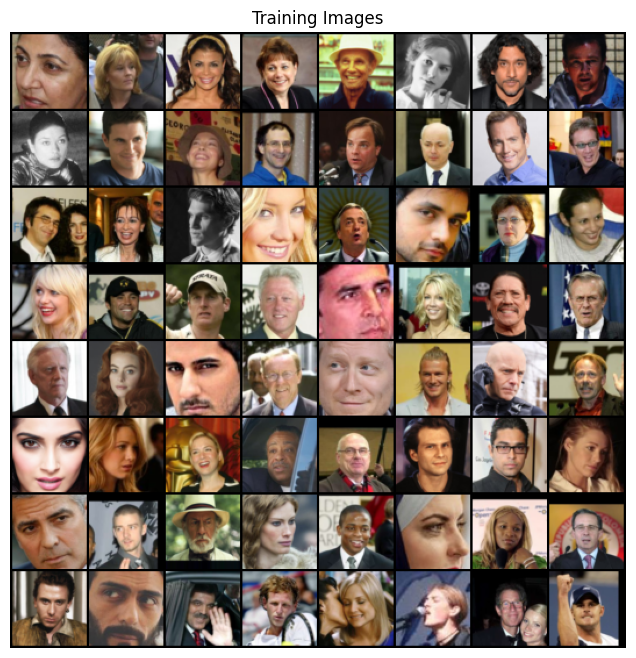

In [12]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [17]:
from model import Generator, Discriminator

checkpoint_path_generator = "savedstate/checkpoint_epoch_700.pth"
checkpoint_path_discriminator = "savedstate/checkpoint_epoch_700.pth"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)
checkpoint_generator = torch.load(checkpoint_path_generator)
checkpoint_discriminator = torch.load(checkpoint_path_discriminator)

checkpoint = "savedstate/checkpoint_epoch_20.pth"
checkpoint_losses = torch.load(checkpoint)
# Load state dictionaries into models
netG.load_state_dict(checkpoint_generator['generator_state_dict'])
netD.load_state_dict(checkpoint_discriminator['discriminator_state_dict'])
netG.eval()
netD.eval()
#loading other saved vars
G_losses = checkpoint_losses['lossG']
D_losses = checkpoint_losses['lossD']
iters = checkpoint_generator['iterations']
epoch = checkpoint_generator['epoch']
img_list = checkpoint_losses['img_list']
img_list2 = checkpoint_losses['img_list']

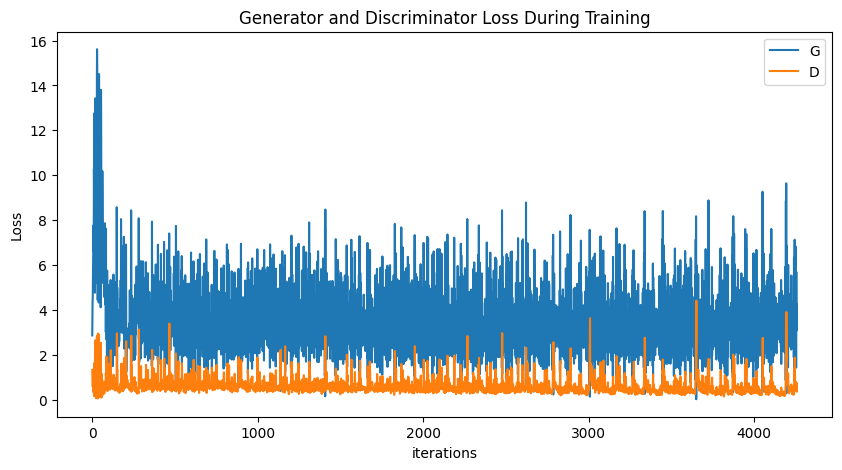

In [18]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

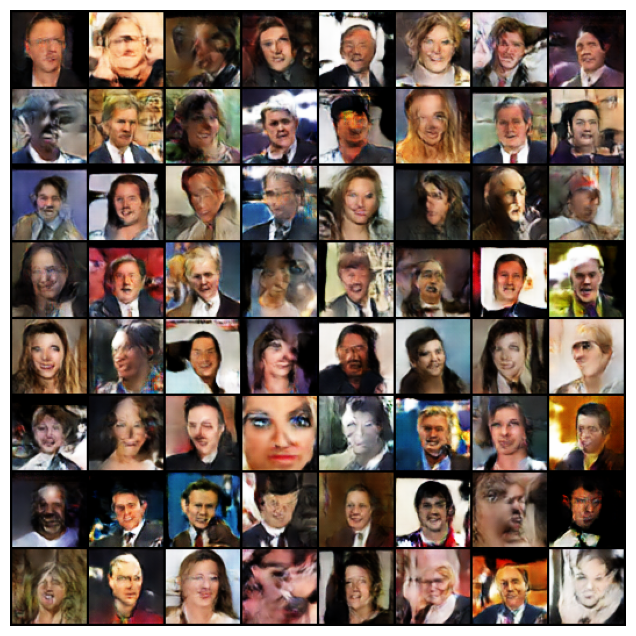

In [15]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
plt.rcParams['animation.embed_limit'] = 250
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

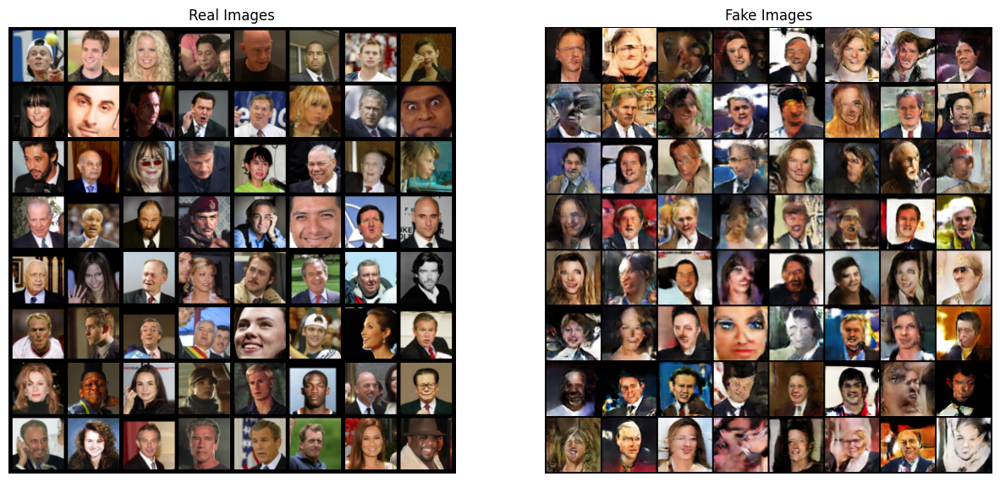

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list2[-1],(1,2,0)))
plt.show()